In [1]:
# import os, certifi
#
# os.environ["SSL_CERT_FILE"] = certifi.where()
# os.environ["REQUESTS_CA_BUNDLE"] = os.environ["SSL_CERT_FILE"]

# import torch
# from torch import nn
# import torch.optim as optim
# from torchvision import datasets, transforms, utils
# from torch.utils.data import DataLoader
# import matplotlib.pyplot as plt
# import numpy as np
#
# device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

import torch
from torch import nn
import torch.optim as optim
from torchvision import datasets, transforms, utils
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [2]:
# 2.1 Hyperparameters and Data Loading
import os
import kagglehub
import torch
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image

# Baseline hyperparameters
latent_dim = 100
hidden_dim = 64
image_size = 64
batch_size = 128
lr_g = 2e-4
lr_d = 2e-4

beta1, beta2 = 0.5, 0.999
num_epochs = 100

transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # scale to [-1, 1] for 3 channels
])

# 1. Download latest version
path = kagglehub.dataset_download("yehongjiang/pokemon-sprites-images")
print("Path to dataset files:", path)

# 2. Custom Dataset to load images from the downloaded path
class SimpleImageDataset(Dataset):
    def __init__(self, root, transform=None):
        self.root = root
        self.transform = transform
        self.image_files = []
        for subdir, dirs, files in os.walk(root):
            for file in files:
                if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
                    self.image_files.append(os.path.join(subdir, file))

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = self.image_files[idx]
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image, 0

train_dataset = SimpleImageDataset(root=path, transform=transform)

# 3. DataLoader
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

print(f"Numar imagini: {len(train_dataset)}")
print(f"Numar batch-uri: {len(train_loader)}")

Using Colab cache for faster access to the 'pokemon-sprites-images' dataset.
Path to dataset files: /kaggle/input/pokemon-sprites-images
Numar imagini: 10177
Numar batch-uri: 79


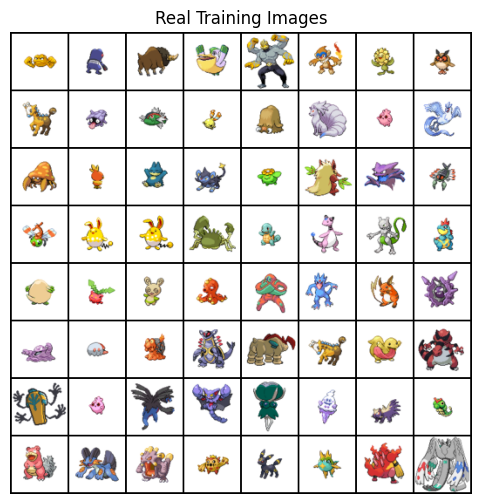

In [3]:
# Visualizing some real samples
real_batch = next(iter(train_loader))
plt.figure(figsize=(6, 6))
plt.axis("off")
plt.title("Real Training Images")
plt.imshow(
    utils.make_grid(real_batch[0][:64], padding=2, normalize=True)
    .cpu()
    .permute(1, 2, 0)
)
plt.show()

In [4]:
class Generator(nn.Module):
    def __init__(self, latent_dim=100, hidden_dim=64, img_channels=3):
        super().__init__()
        self.net = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(latent_dim, hidden_dim * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(hidden_dim * 8),
            nn.ReLU(True),
            # state size. (hidden_dim*8) x 4 x 4
            nn.ConvTranspose2d(hidden_dim * 8, hidden_dim * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(hidden_dim * 4),
            nn.ReLU(True),
            # state size. (hidden_dim*4) x 8 x 8
            nn.ConvTranspose2d(hidden_dim * 4, hidden_dim * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(hidden_dim * 2),
            nn.ReLU(True),
            # state size. (hidden_dim*2) x 16 x 16
            nn.ConvTranspose2d(hidden_dim * 2, hidden_dim, 4, 2, 1, bias=False),
            nn.BatchNorm2d(hidden_dim),
            nn.ReLU(True),
            # state size. (hidden_dim) x 32 x 32
            nn.ConvTranspose2d(hidden_dim, img_channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (img_channels) x 64 x 64
        )

    def forward(self, z):
        # z: (batch_size, latent_dim) -> (batch_size, latent_dim, 1, 1)
        z = z.view(z.size(0), z.size(1), 1, 1)
        return self.net(z)


class Discriminator(nn.Module):
    def __init__(self, img_channels=3, hidden_dim=64):
        super().__init__()
        self.net = nn.Sequential(
            # input is (img_channels) x 64 x 64
            nn.Conv2d(img_channels, hidden_dim, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (hidden_dim) x 32 x 32
            nn.Conv2d(hidden_dim, hidden_dim * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(hidden_dim * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (hidden_dim*2) x 16 x 16
            nn.Conv2d(hidden_dim * 2, hidden_dim * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(hidden_dim * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (hidden_dim*4) x 8 x 8
            nn.Conv2d(hidden_dim * 4, hidden_dim * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(hidden_dim * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (hidden_dim*8) x 4 x 4
            nn.Conv2d(hidden_dim * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.net(x).view(-1, 1)

In [5]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

G = Generator(latent_dim=latent_dim, hidden_dim=hidden_dim, img_channels=3).to(device)
D = Discriminator(img_channels=3, hidden_dim=hidden_dim).to(device)

G.apply(weights_init)
D.apply(weights_init)

criterion = nn.BCELoss()

optimizer_G = optim.Adam(
    G.parameters(),
    lr=2e-4,
    betas=(0.5, 0.999)
)

optimizer_D = optim.Adam(
    D.parameters(),
    lr=2e-4,
    betas=(0.5, 0.999)
)

In [6]:
#Visualizing generated samples helper
def show_fake_samples(epoch, fixed_noise, nrow=8):
    G.eval()
    with torch.no_grad():
        fake = G(fixed_noise.to(device))
    G.train()
    fake = (fake + 1) / 2.0  # back to [0, 1] for display
    grid = utils.make_grid(fake, nrow=nrow)
    plt.figure(figsize=(6, 6))
    plt.title(f"Generated samples at epoch {epoch}")
    plt.axis('off')
    plt.imshow(grid.cpu().permute(1, 2, 0).squeeze())
    plt.show()


fixed_noise = torch.randn(64, latent_dim, device=device)

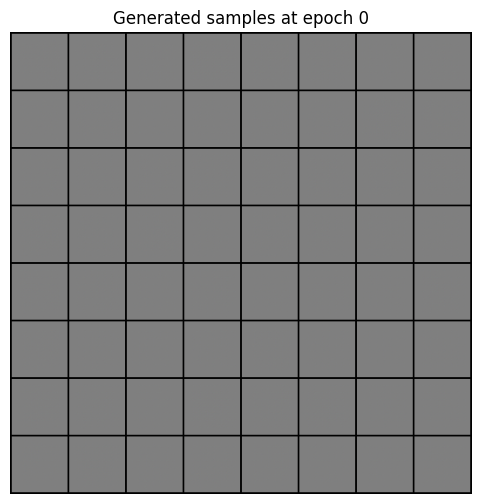

In [7]:
show_fake_samples(0, fixed_noise)

Epoch [1/100]  D_loss: 0.4572  G_loss: 5.4664


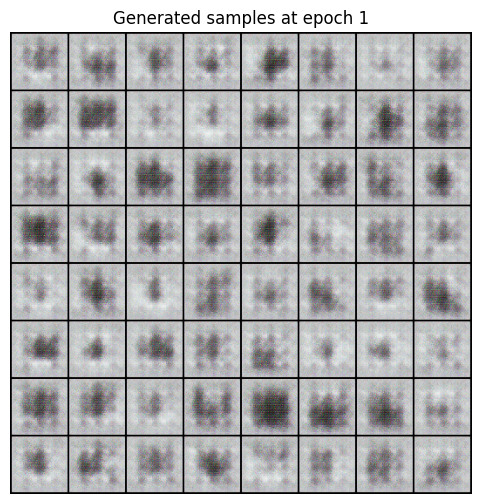

Epoch [2/100]  D_loss: 0.1448  G_loss: 5.1396


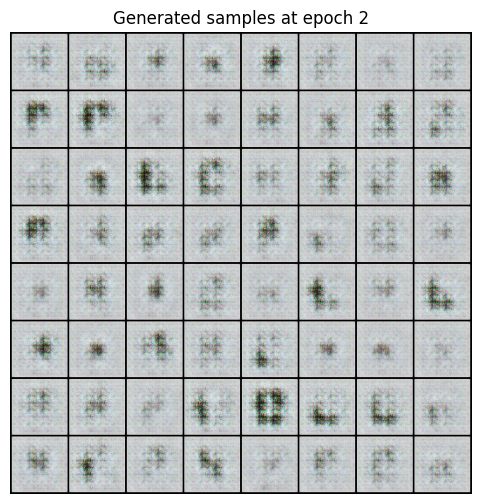

Epoch [3/100]  D_loss: 0.7065  G_loss: 2.0024


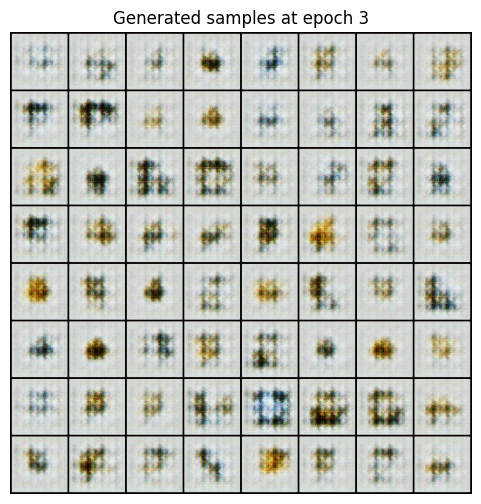

Epoch [4/100]  D_loss: 0.2827  G_loss: 4.7666


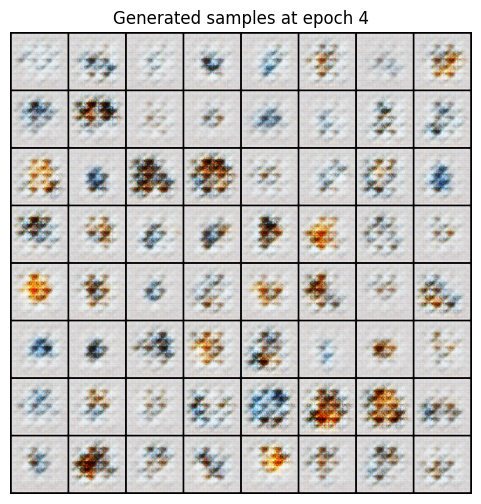

Epoch [5/100]  D_loss: 0.4411  G_loss: 7.4114


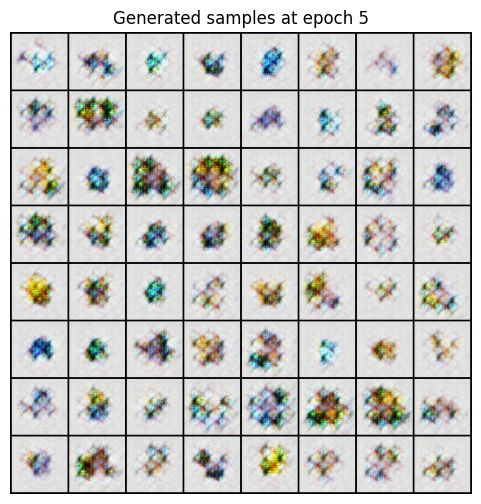

Epoch [6/100]  D_loss: 0.2811  G_loss: 5.1025


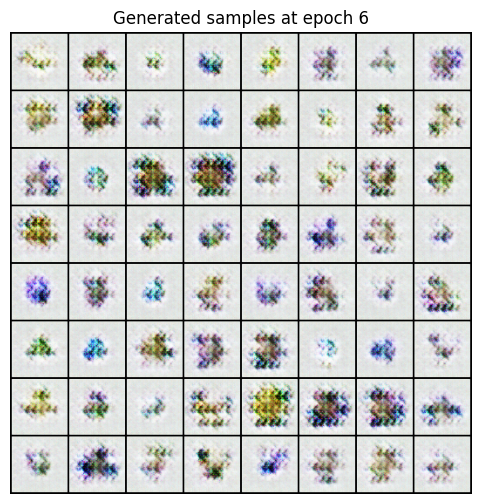

Epoch [7/100]  D_loss: 0.2888  G_loss: 5.2162


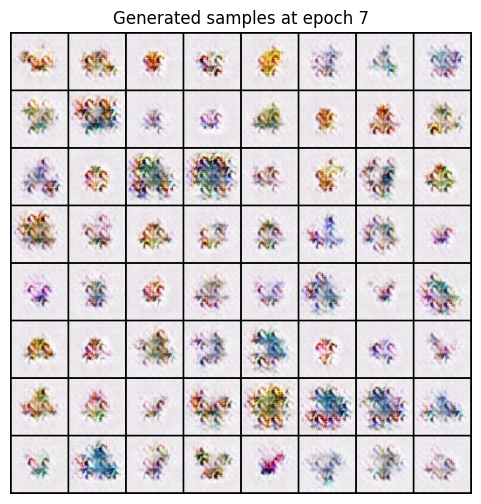

Epoch [8/100]  D_loss: 0.3405  G_loss: 3.9385


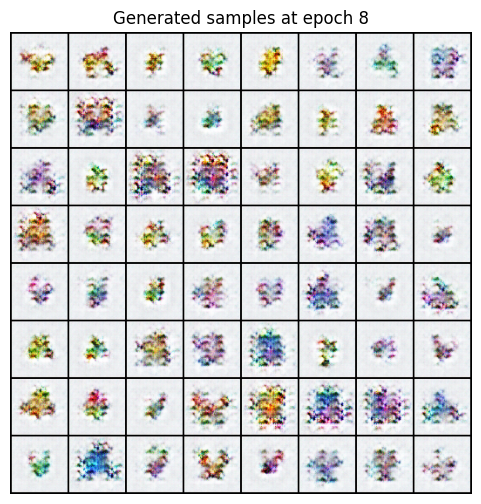

Epoch [9/100]  D_loss: 0.4774  G_loss: 3.7979


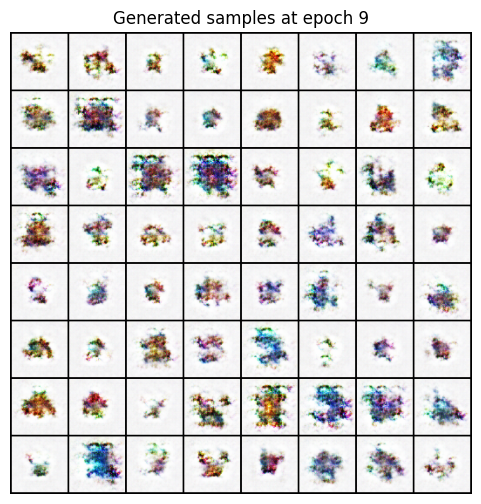

Epoch [10/100]  D_loss: 0.5007  G_loss: 4.9330


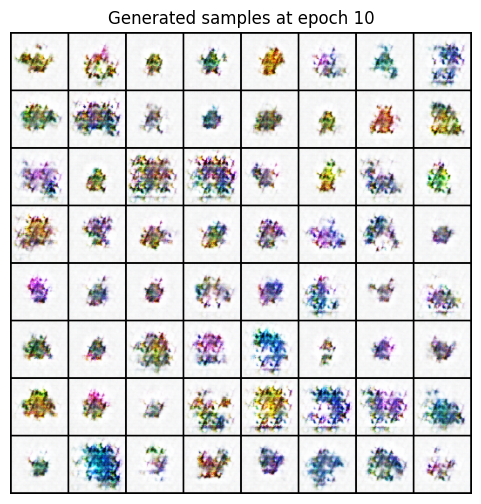

Epoch [11/100]  D_loss: 0.5205  G_loss: 4.5000


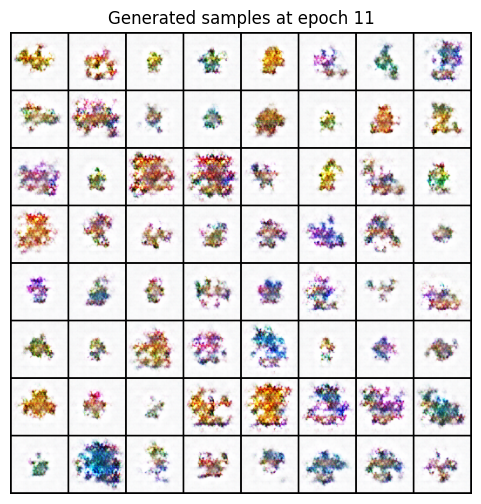

Epoch [12/100]  D_loss: 0.6025  G_loss: 2.7652


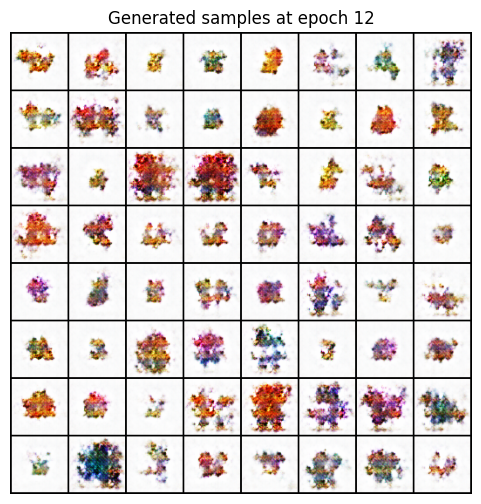

Epoch [13/100]  D_loss: 1.0922  G_loss: 2.6147


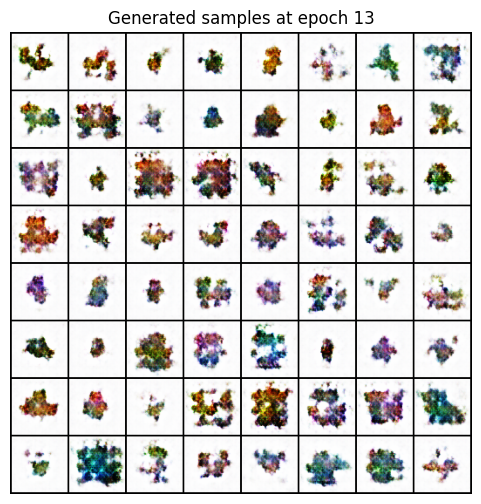

Epoch [14/100]  D_loss: 0.5907  G_loss: 3.1404


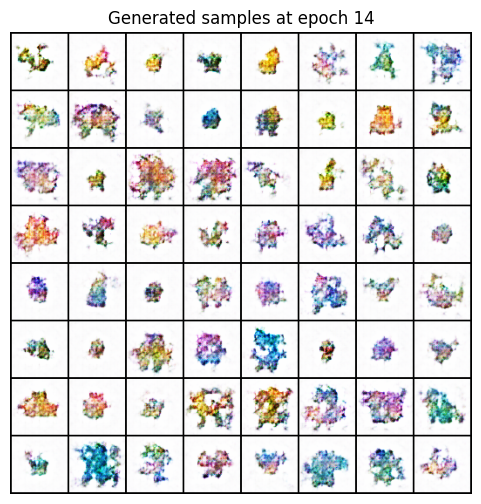

Epoch [15/100]  D_loss: 0.6626  G_loss: 3.4430


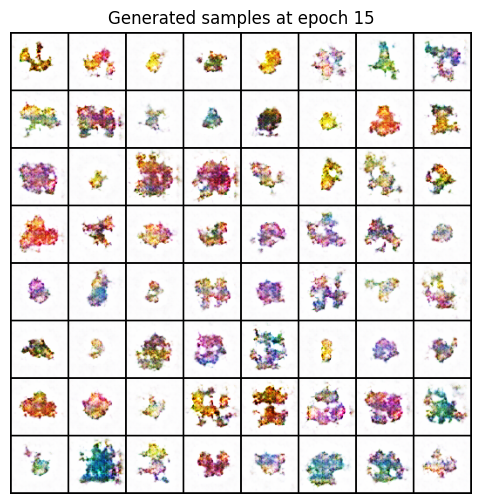

Epoch [16/100]  D_loss: 0.8242  G_loss: 1.1208


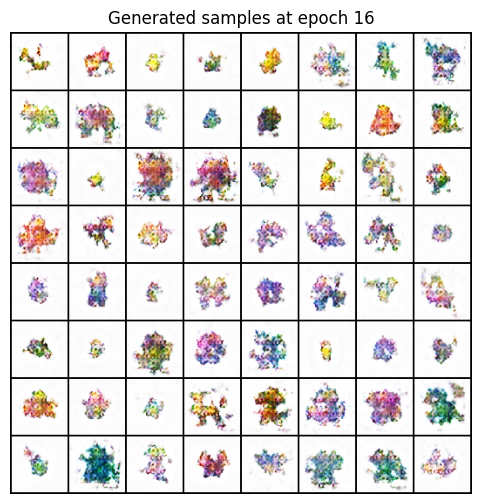

Epoch [17/100]  D_loss: 0.8343  G_loss: 5.3931


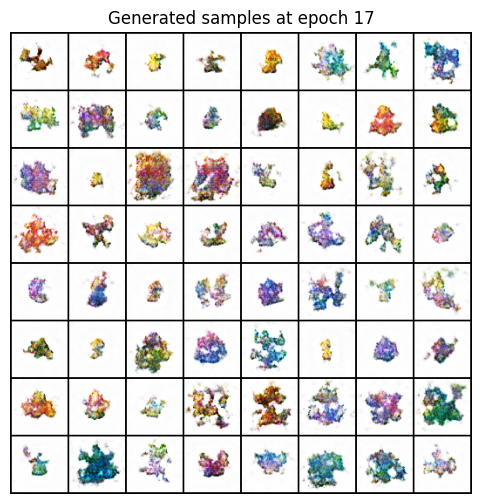

Epoch [18/100]  D_loss: 0.8270  G_loss: 2.9582


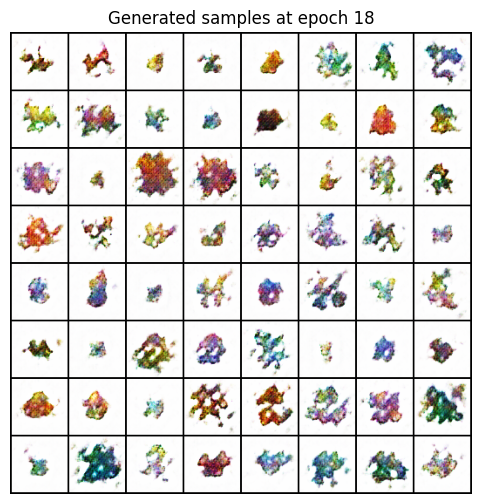

Epoch [19/100]  D_loss: 1.3724  G_loss: 4.8758


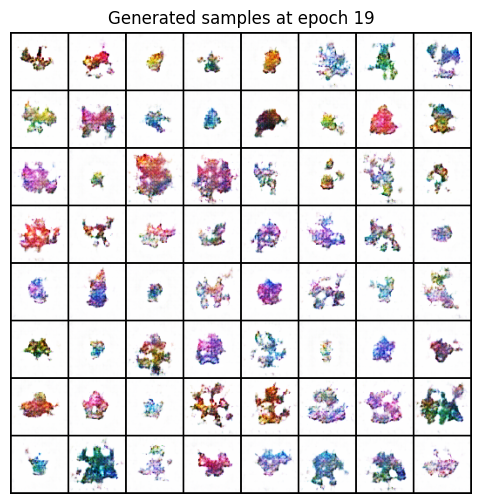

Epoch [20/100]  D_loss: 0.6196  G_loss: 2.5146


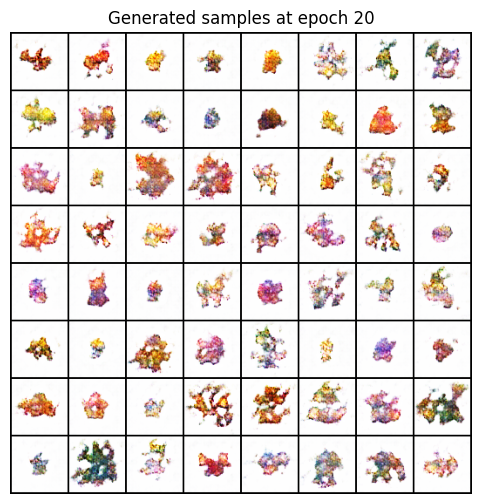

Epoch [21/100]  D_loss: 0.6097  G_loss: 2.2536


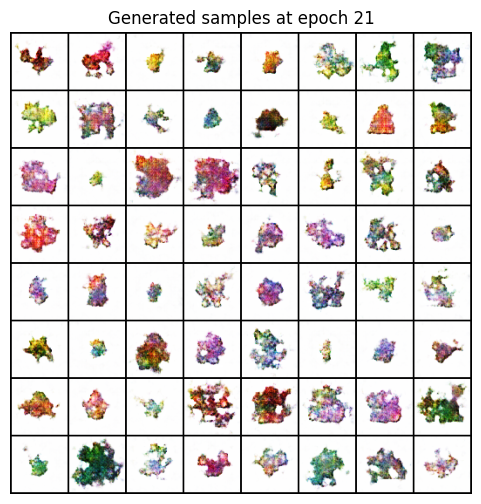

Epoch [22/100]  D_loss: 0.9560  G_loss: 2.3993


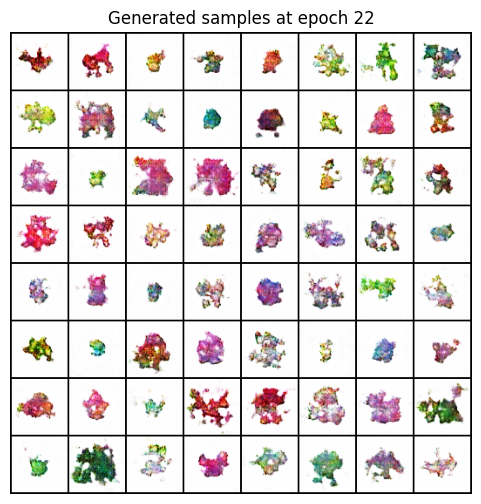

Epoch [23/100]  D_loss: 0.9876  G_loss: 1.0102


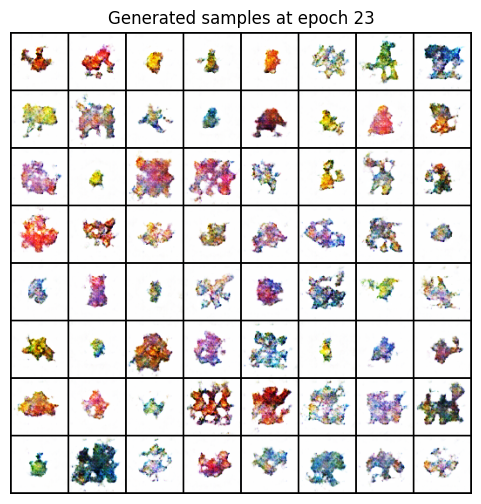

Epoch [24/100]  D_loss: 0.6592  G_loss: 3.7207


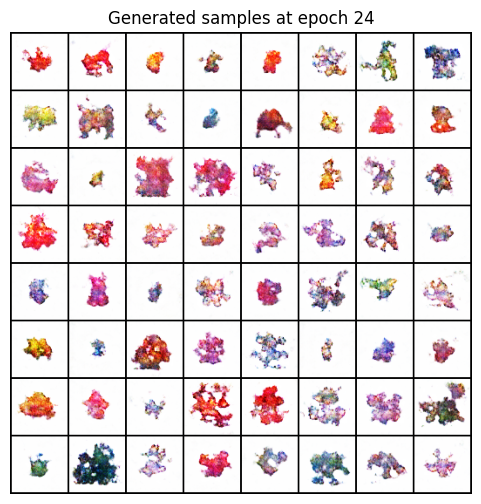

Epoch [25/100]  D_loss: 0.7654  G_loss: 1.7339


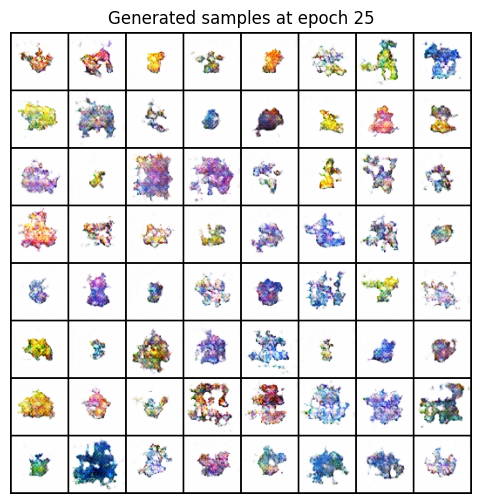

Epoch [26/100]  D_loss: 0.6744  G_loss: 3.2871


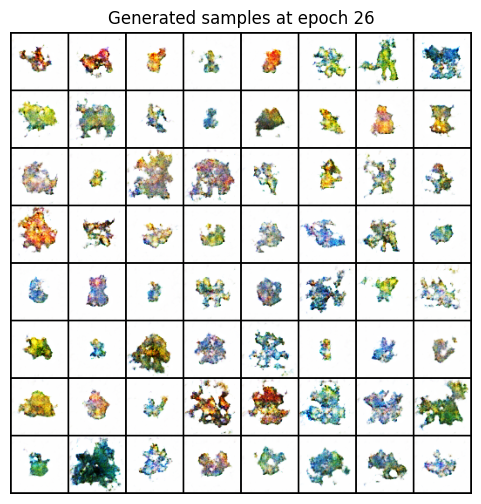

Epoch [27/100]  D_loss: 0.6930  G_loss: 3.4206


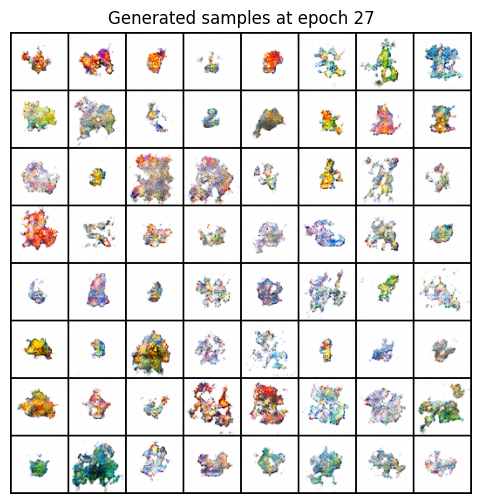

Epoch [28/100]  D_loss: 0.5857  G_loss: 2.9445


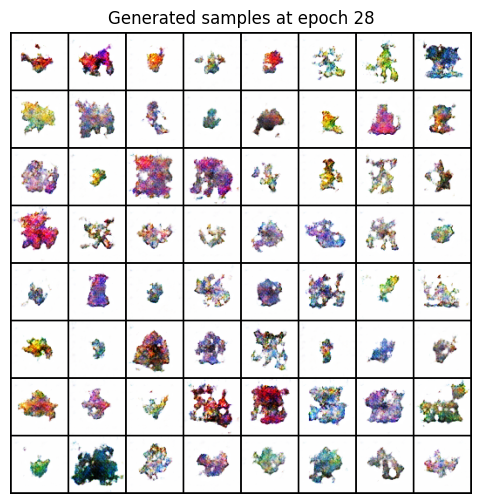

Epoch [29/100]  D_loss: 1.6318  G_loss: 5.3785


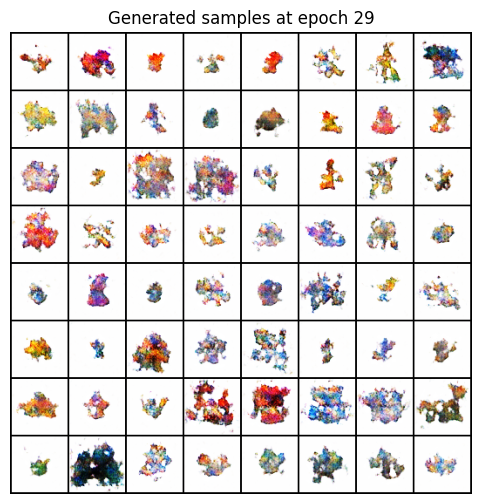

Epoch [30/100]  D_loss: 0.6832  G_loss: 3.9239


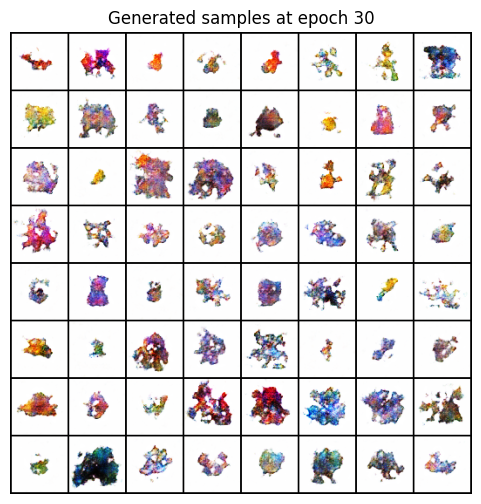

Epoch [31/100]  D_loss: 0.5847  G_loss: 2.8171


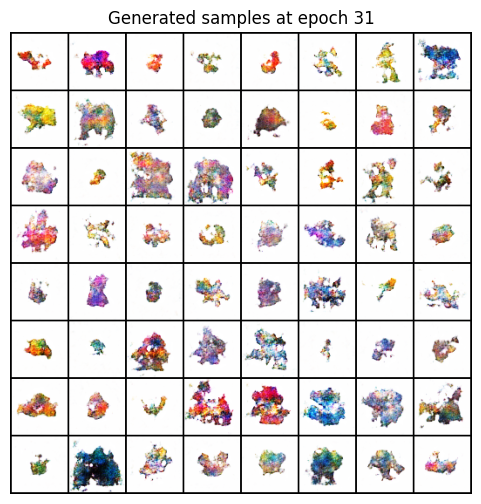

Epoch [32/100]  D_loss: 0.4766  G_loss: 2.3310


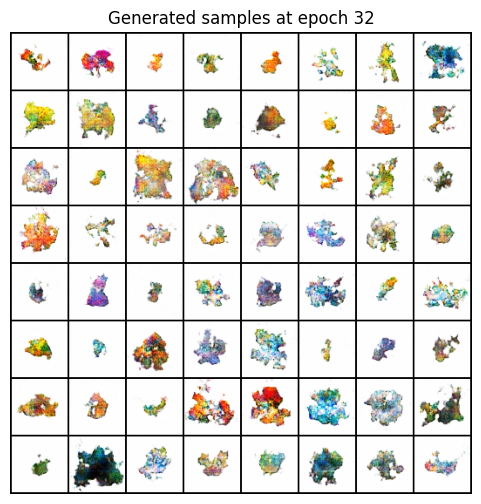

Epoch [33/100]  D_loss: 0.5000  G_loss: 2.8315


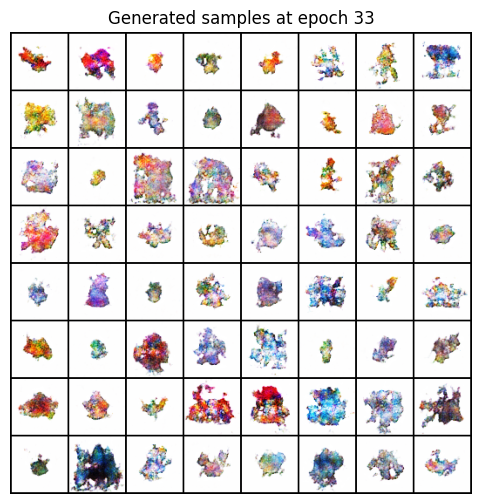

Epoch [34/100]  D_loss: 0.5819  G_loss: 3.5785


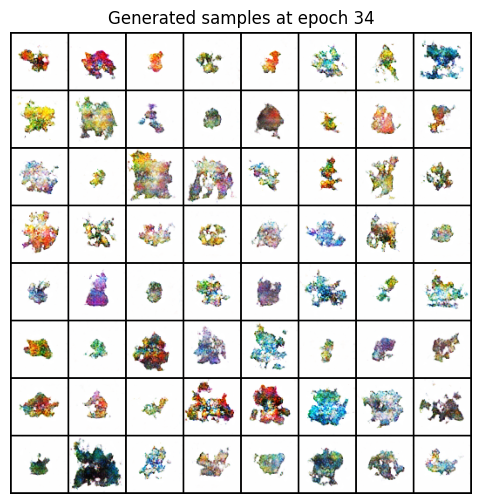

Epoch [35/100]  D_loss: 0.6269  G_loss: 2.1375


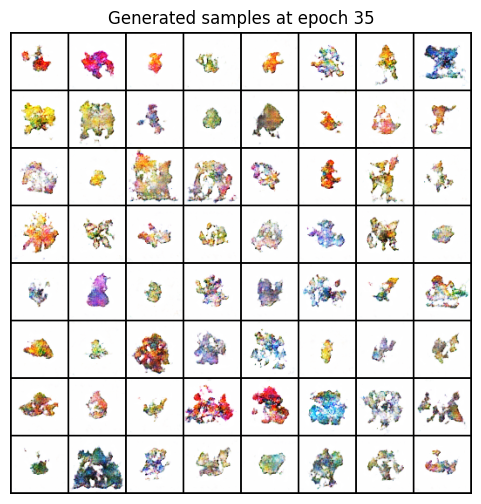

Epoch [36/100]  D_loss: 0.4932  G_loss: 2.1309


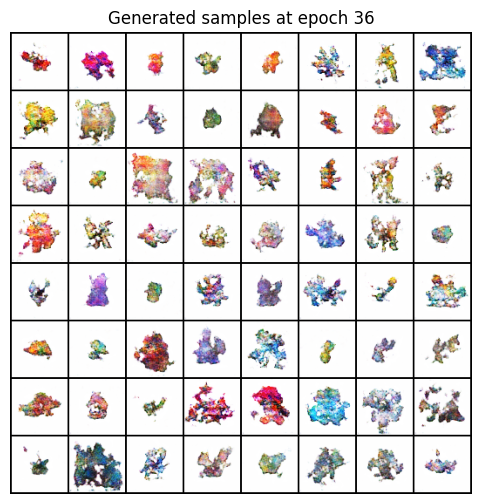

Epoch [37/100]  D_loss: 0.4508  G_loss: 3.5030


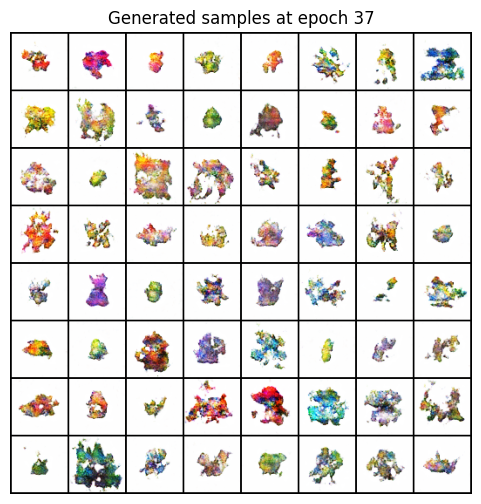

Epoch [38/100]  D_loss: 0.4796  G_loss: 3.0825


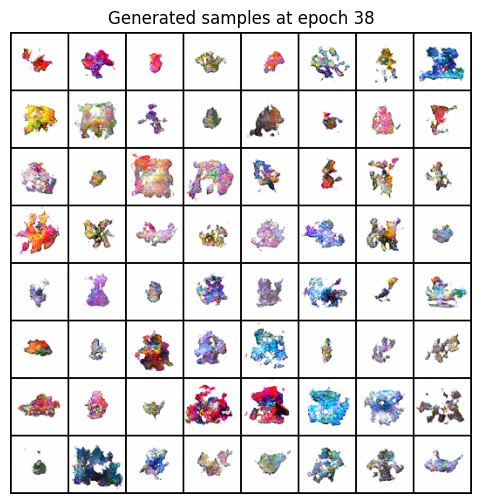

Epoch [39/100]  D_loss: 0.4089  G_loss: 2.8307


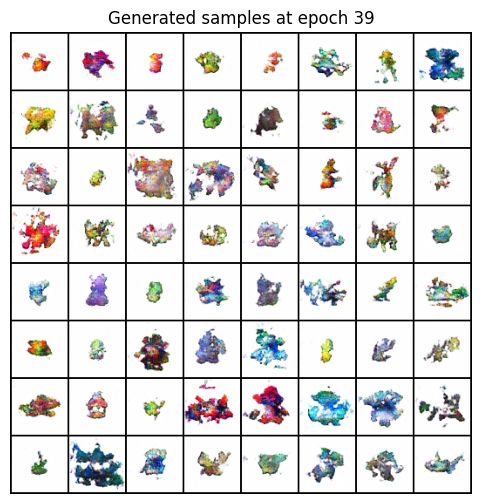

Epoch [40/100]  D_loss: 0.6055  G_loss: 1.6038


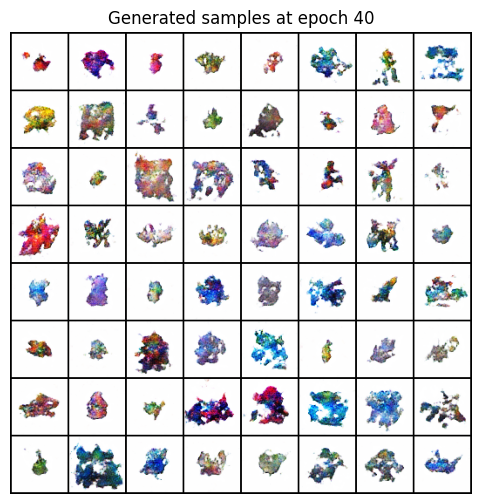

Epoch [41/100]  D_loss: 0.5361  G_loss: 3.6604


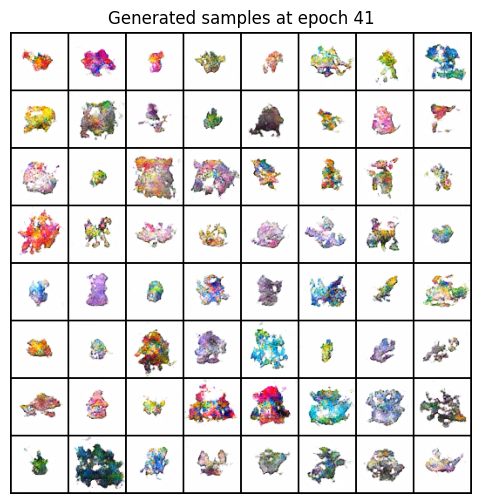

Epoch [42/100]  D_loss: 0.4477  G_loss: 3.3164


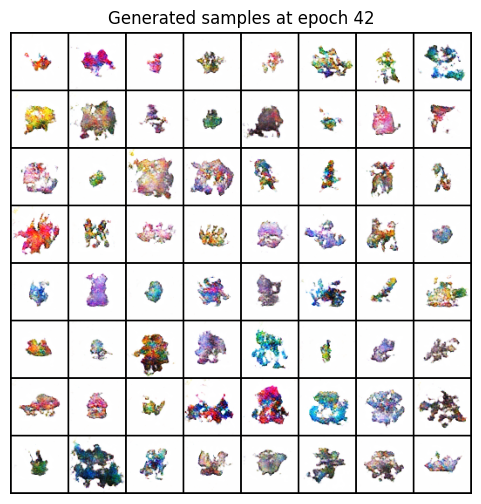

Epoch [43/100]  D_loss: 0.3410  G_loss: 2.7015


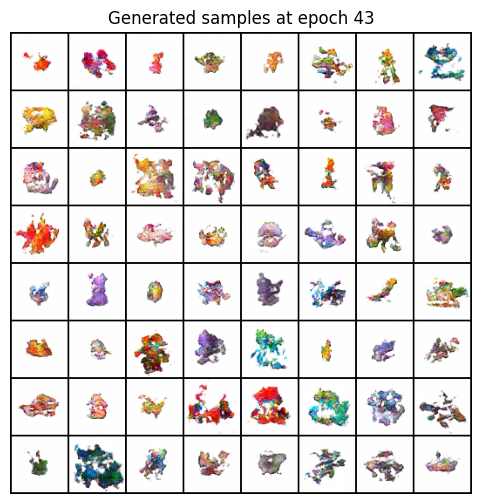

Epoch [44/100]  D_loss: 0.3277  G_loss: 2.7396


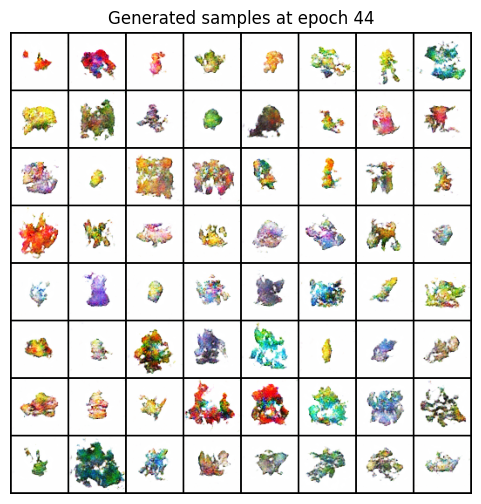

Epoch [45/100]  D_loss: 0.4819  G_loss: 2.9822


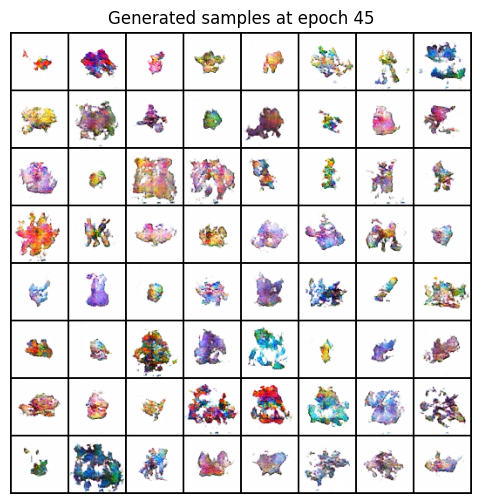

Epoch [46/100]  D_loss: 0.3246  G_loss: 2.6759


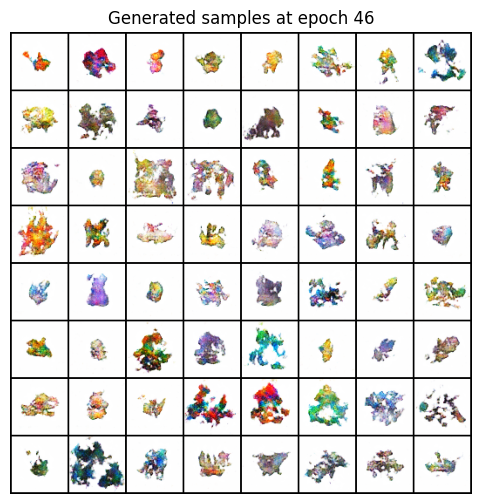

Epoch [47/100]  D_loss: 0.4533  G_loss: 1.8880


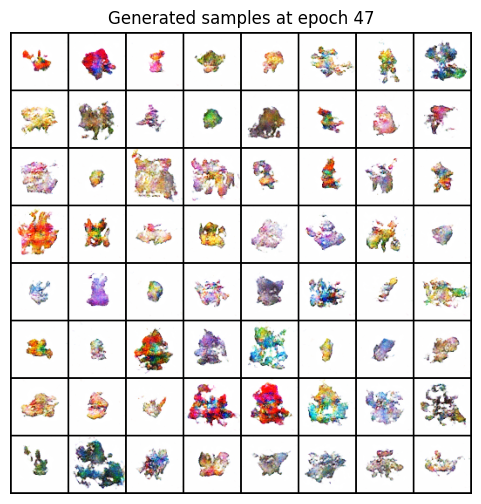

Epoch [48/100]  D_loss: 0.3172  G_loss: 3.9644


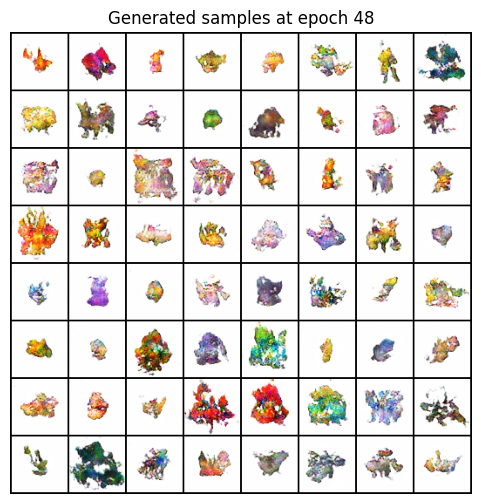

Epoch [49/100]  D_loss: 0.4786  G_loss: 2.1626


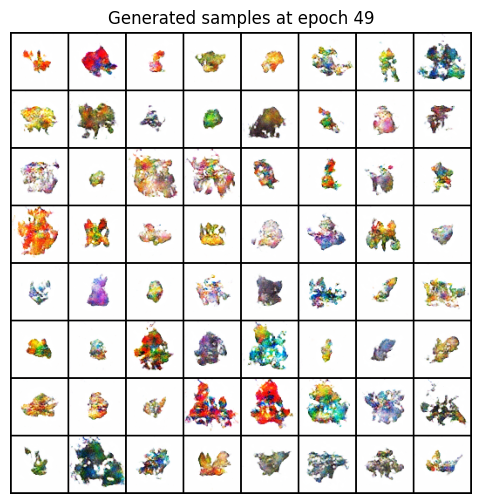

Epoch [50/100]  D_loss: 0.4148  G_loss: 3.6829


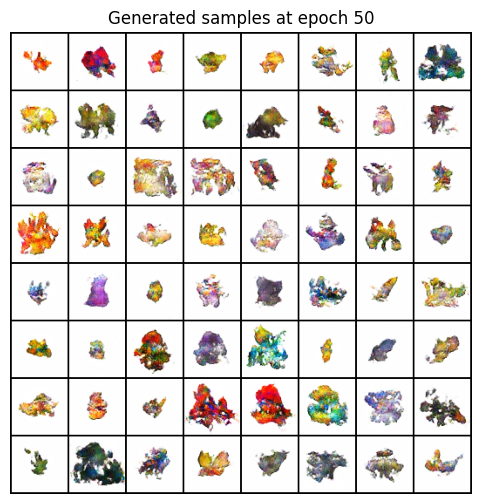

Epoch [51/100]  D_loss: 0.2690  G_loss: 3.4307


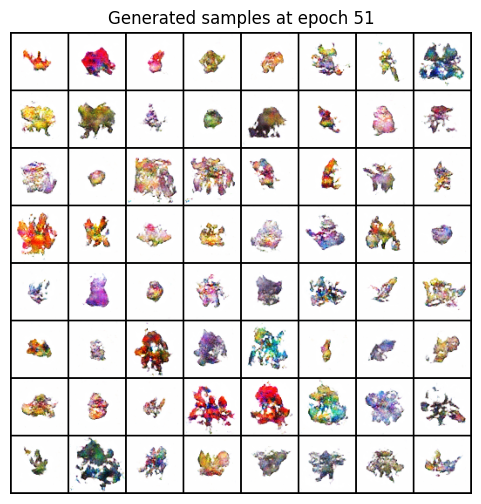

Epoch [52/100]  D_loss: 0.2762  G_loss: 2.9438


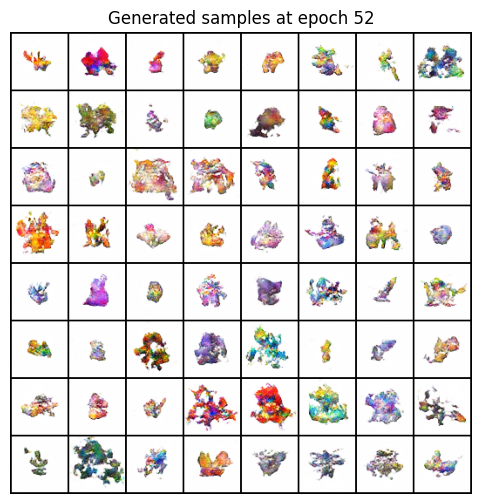

Epoch [53/100]  D_loss: 0.2416  G_loss: 3.8763


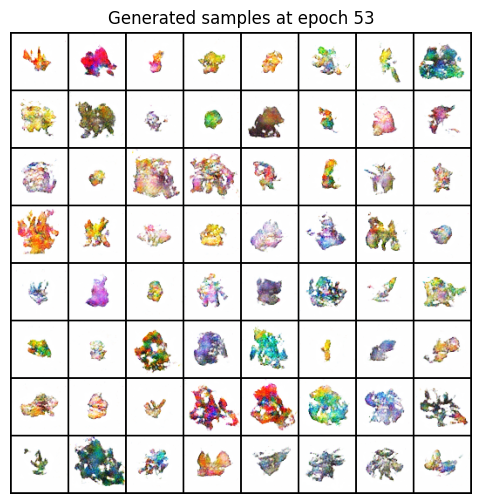

Epoch [54/100]  D_loss: 0.1948  G_loss: 3.7078


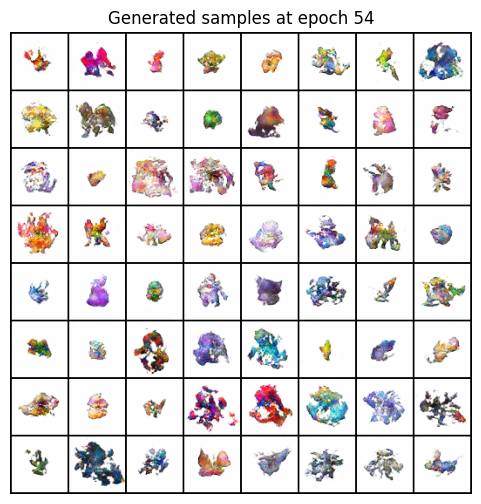

Epoch [55/100]  D_loss: 0.2798  G_loss: 3.5612


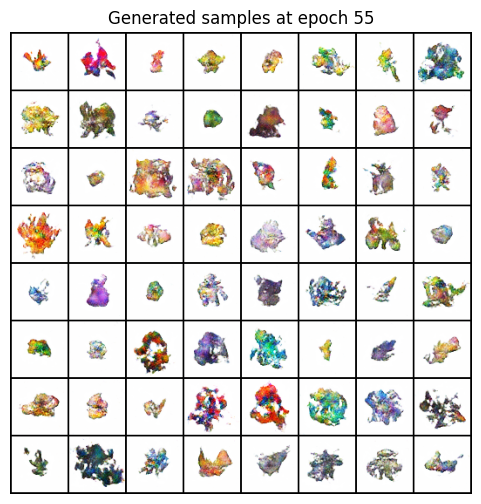

Epoch [56/100]  D_loss: 0.1556  G_loss: 3.8110


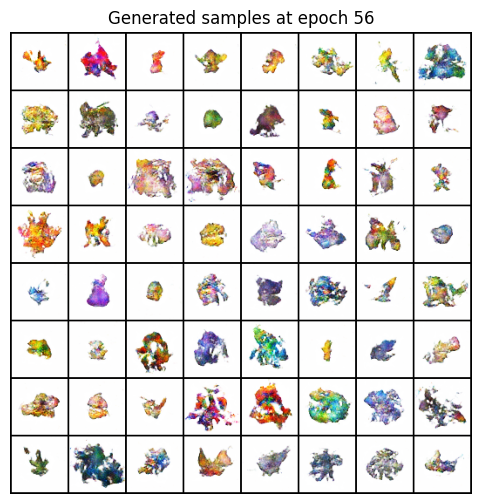

Epoch [57/100]  D_loss: 0.4129  G_loss: 4.1141


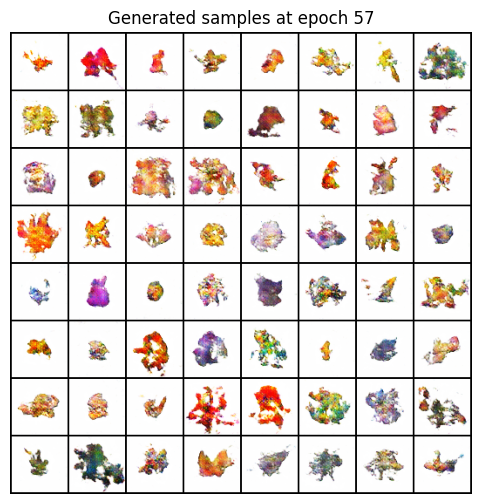

Epoch [58/100]  D_loss: 0.1974  G_loss: 3.1321


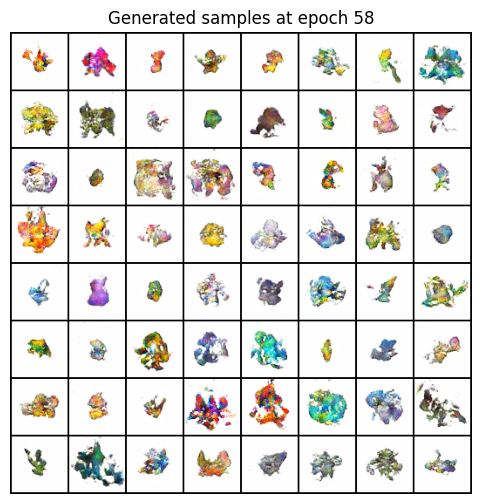

Epoch [59/100]  D_loss: 0.1733  G_loss: 3.3415


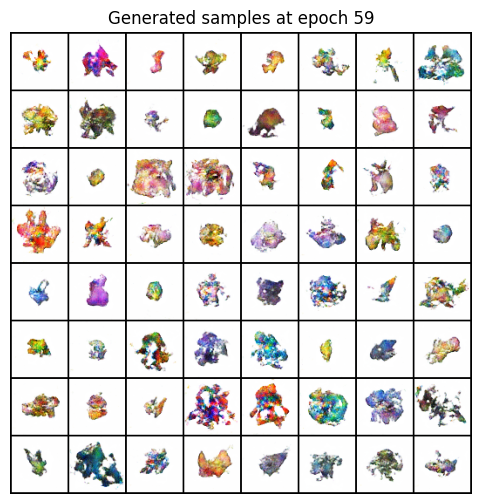

Epoch [60/100]  D_loss: 0.1868  G_loss: 3.6152


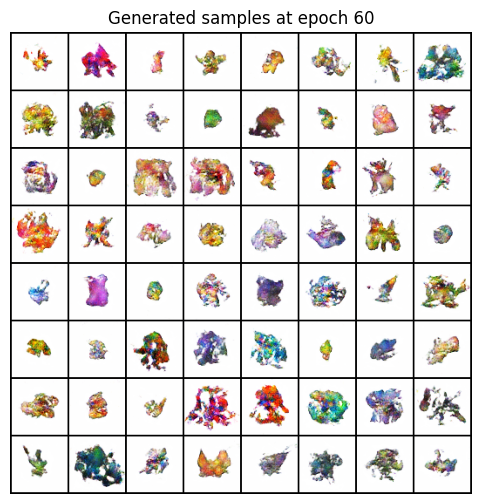

Epoch [61/100]  D_loss: 0.1502  G_loss: 3.2302


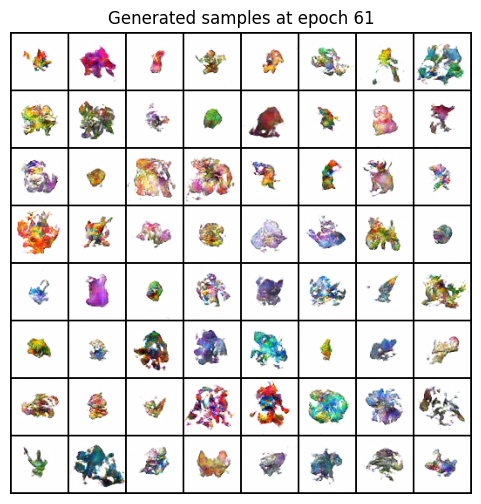

Epoch [62/100]  D_loss: 0.1500  G_loss: 3.6641


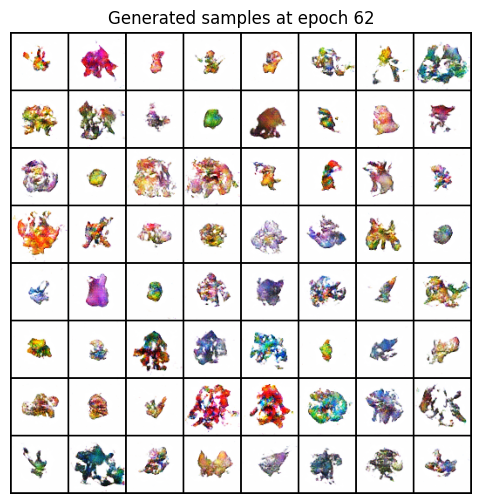

Epoch [63/100]  D_loss: 0.1329  G_loss: 3.8762


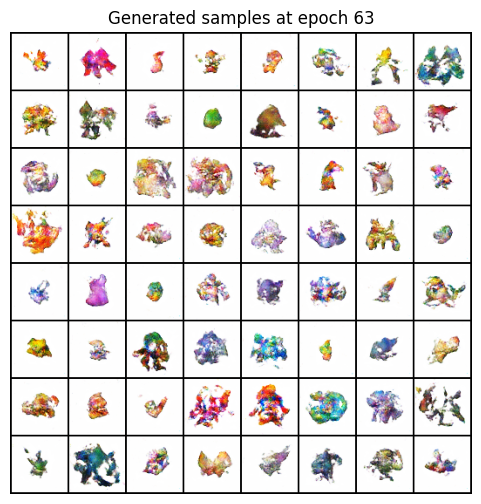

Epoch [64/100]  D_loss: 0.8968  G_loss: 6.2776


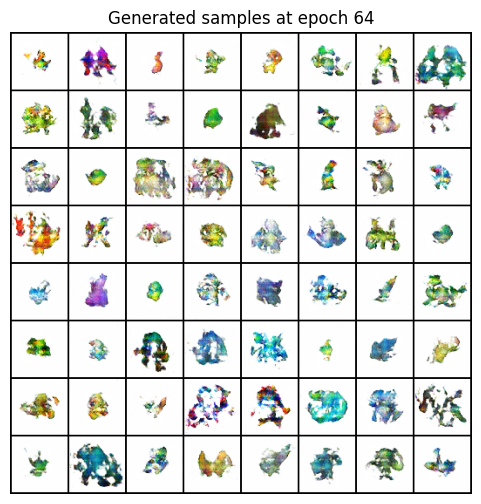

Epoch [65/100]  D_loss: 0.1963  G_loss: 3.5190


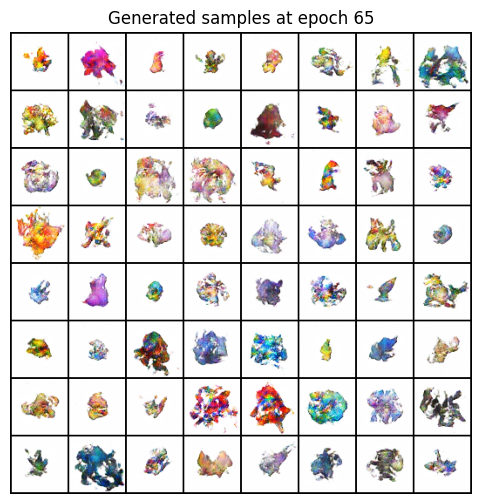

Epoch [66/100]  D_loss: 0.1545  G_loss: 3.8646


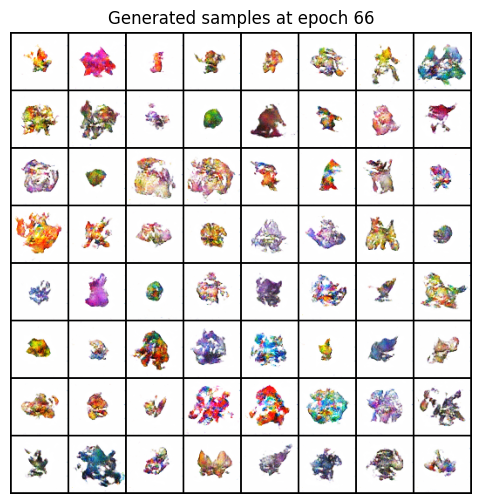

Epoch [67/100]  D_loss: 0.1165  G_loss: 3.9009


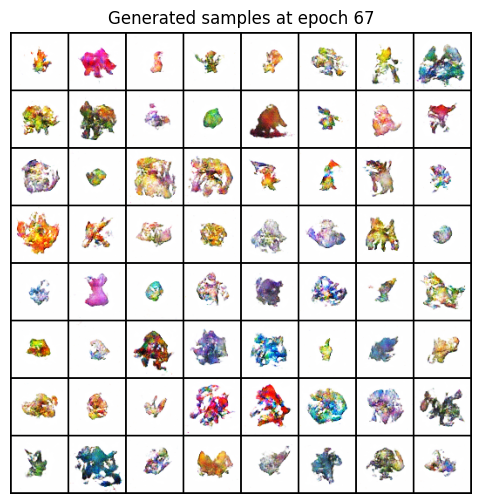

Epoch [68/100]  D_loss: 0.1393  G_loss: 4.3852


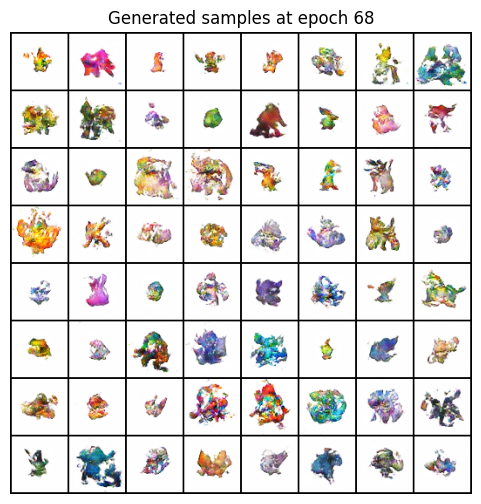

Epoch [69/100]  D_loss: 0.9717  G_loss: 4.4494


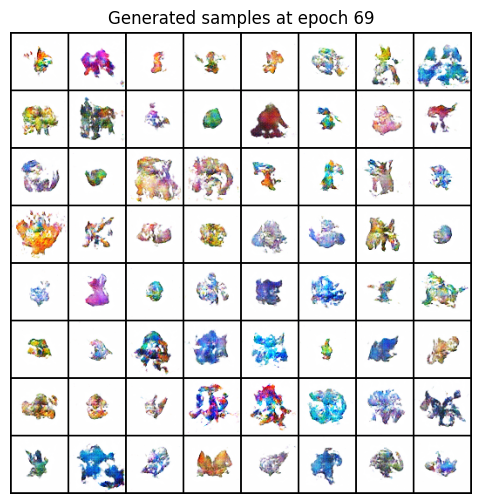

Epoch [70/100]  D_loss: 0.2139  G_loss: 4.1910


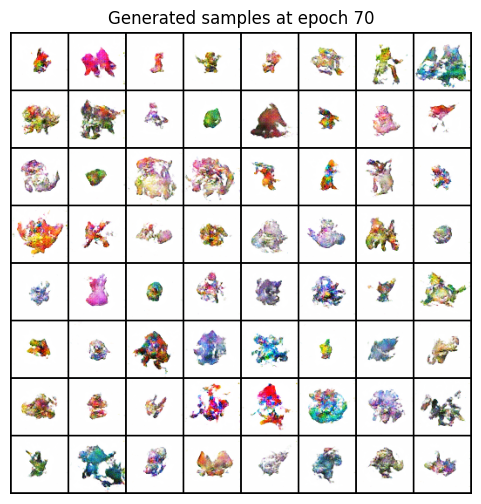

Epoch [71/100]  D_loss: 0.1518  G_loss: 3.7095


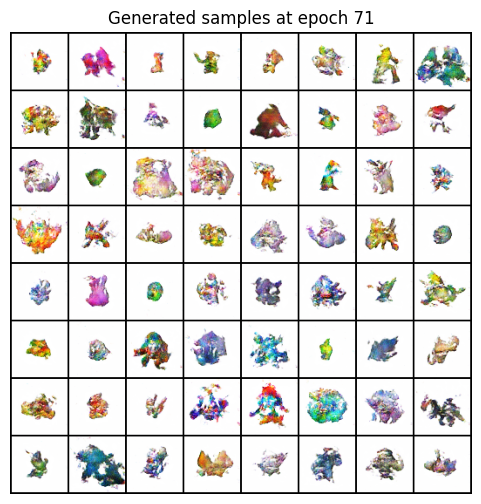

Epoch [72/100]  D_loss: 0.1258  G_loss: 4.0145


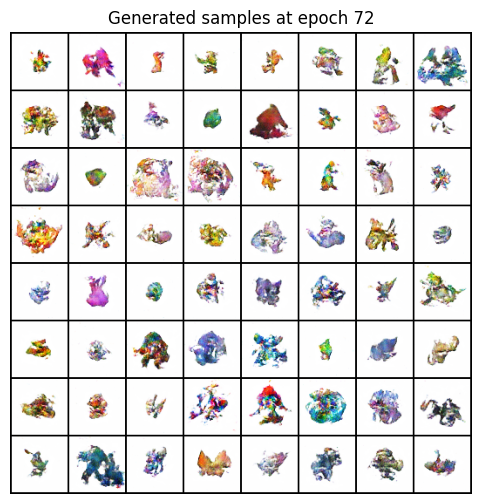

Epoch [73/100]  D_loss: 0.1567  G_loss: 3.0802


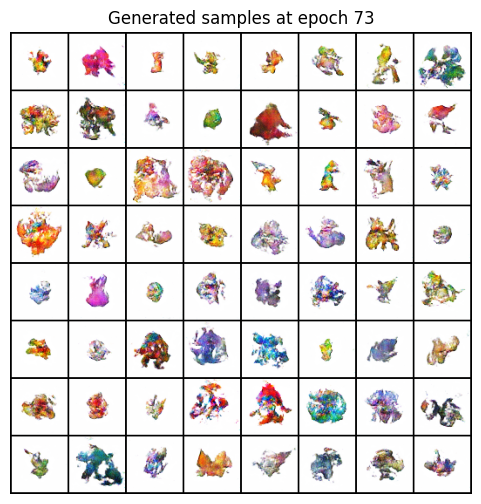

Epoch [74/100]  D_loss: 0.0904  G_loss: 4.0559


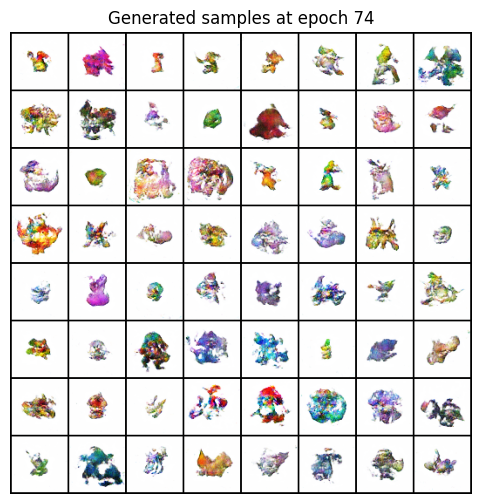

Epoch [75/100]  D_loss: 0.0928  G_loss: 4.2971


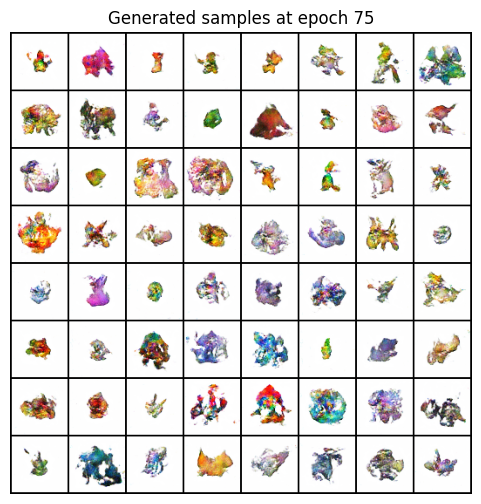

Epoch [76/100]  D_loss: 0.0999  G_loss: 3.8377


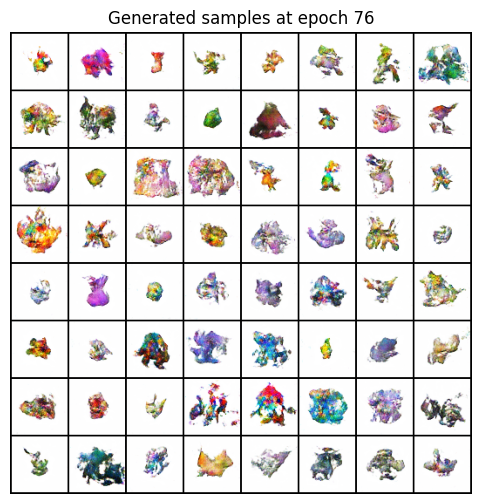

Epoch [77/100]  D_loss: 0.0750  G_loss: 4.1799


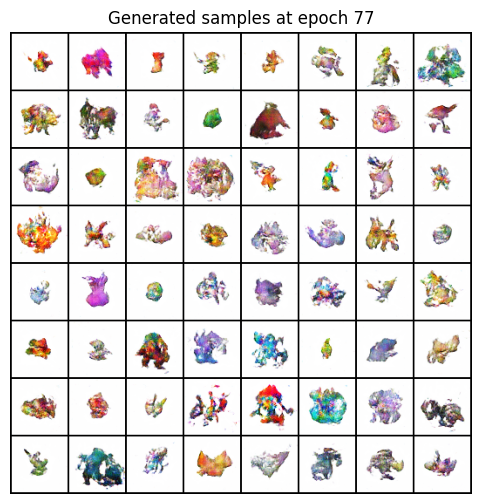

Epoch [78/100]  D_loss: 1.3076  G_loss: 0.9922


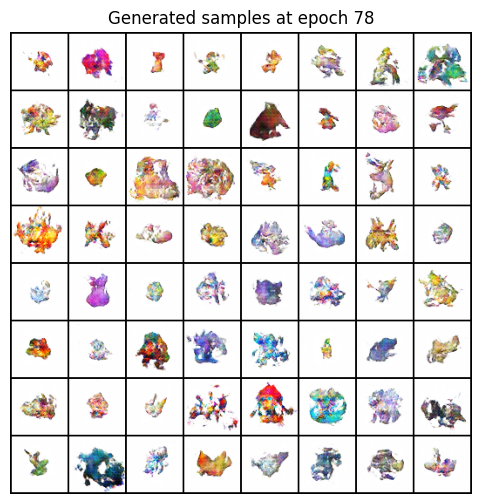

Epoch [79/100]  D_loss: 0.6195  G_loss: 3.6067


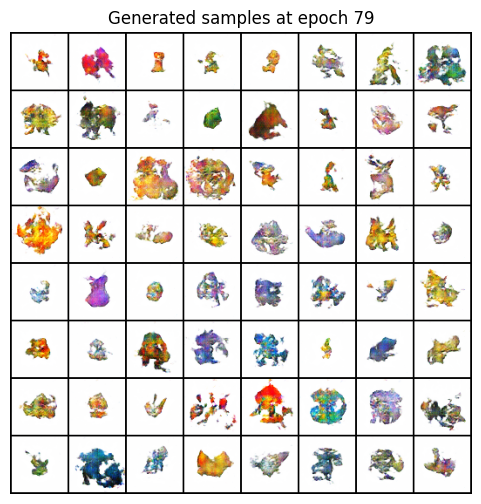

Epoch [80/100]  D_loss: 0.2609  G_loss: 3.2438


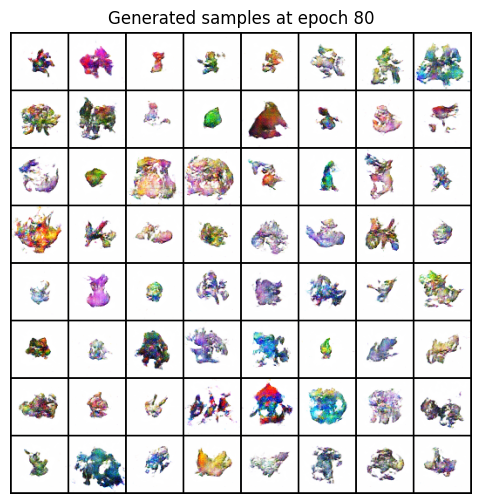

Epoch [81/100]  D_loss: 0.1762  G_loss: 3.4624


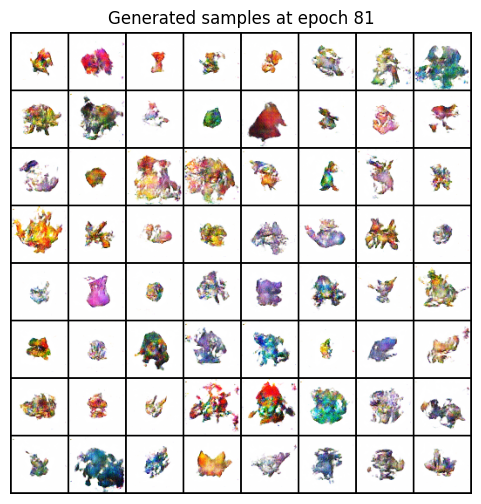

Epoch [82/100]  D_loss: 0.1137  G_loss: 4.2869


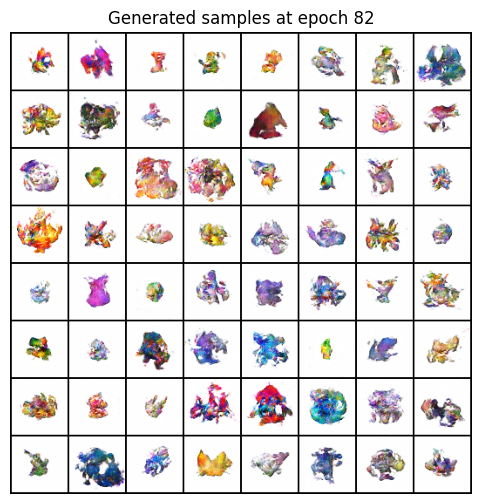

Epoch [83/100]  D_loss: 0.0822  G_loss: 3.9883


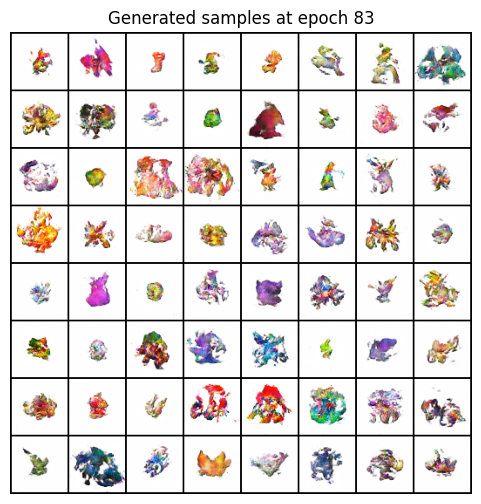

Epoch [84/100]  D_loss: 0.0680  G_loss: 3.9097


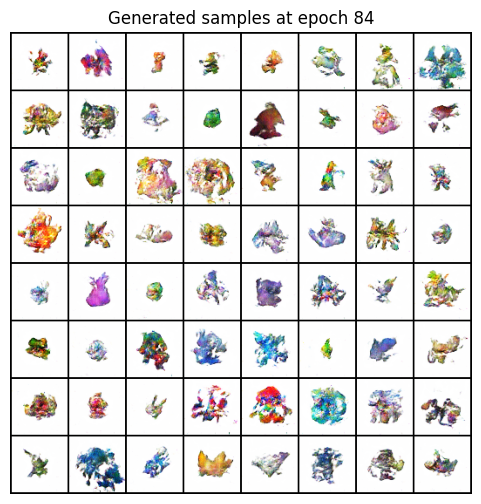

Epoch [85/100]  D_loss: 0.0826  G_loss: 3.7487


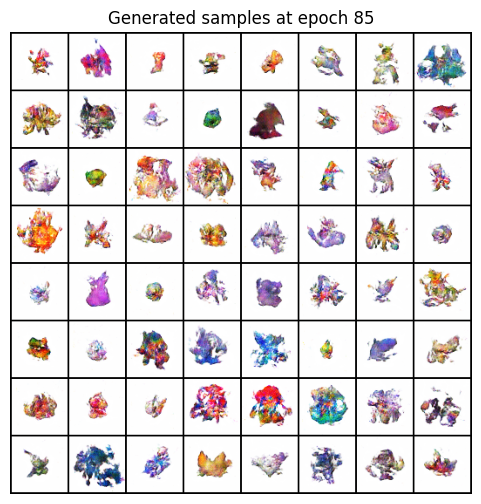

Epoch [86/100]  D_loss: 0.0667  G_loss: 4.2365


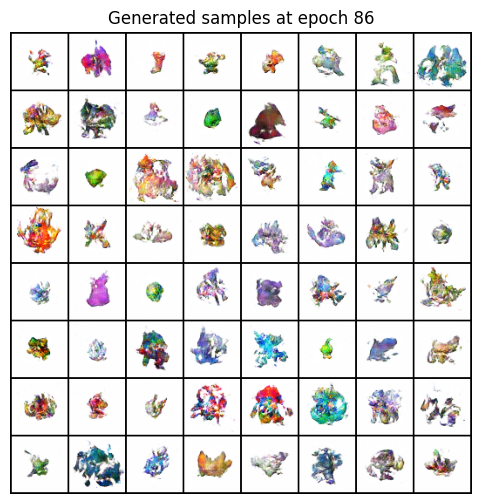

Epoch [87/100]  D_loss: 0.0920  G_loss: 5.3991


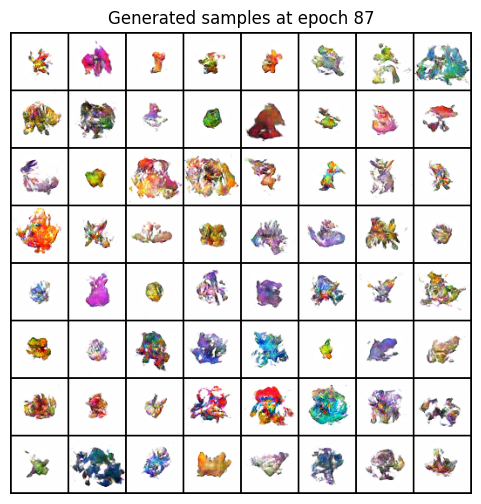

Epoch [88/100]  D_loss: 0.0688  G_loss: 4.2488


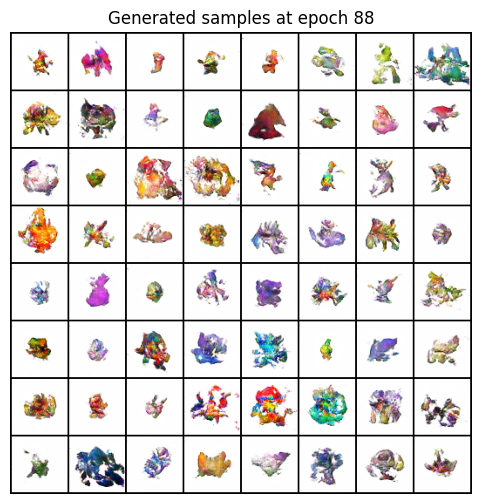

Epoch [89/100]  D_loss: 0.9517  G_loss: 1.8185


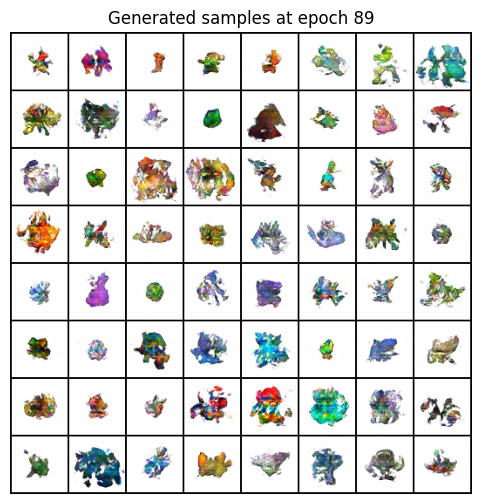

Epoch [90/100]  D_loss: 0.1591  G_loss: 4.3713


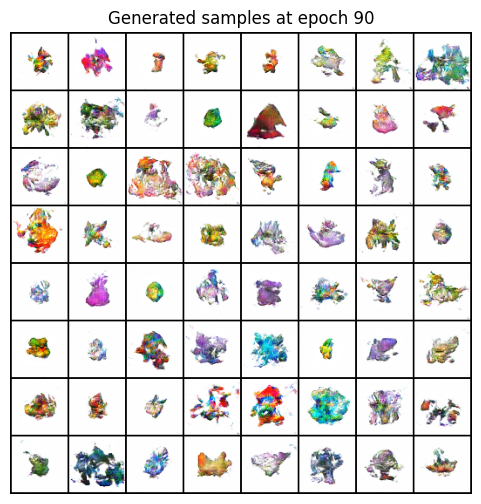

Epoch [91/100]  D_loss: 0.0723  G_loss: 4.7906


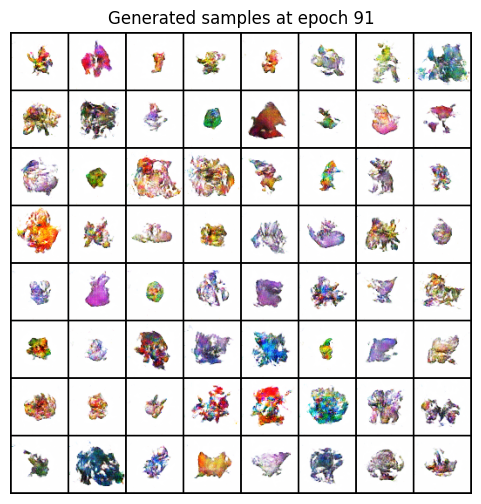

Epoch [92/100]  D_loss: 0.0666  G_loss: 4.3647


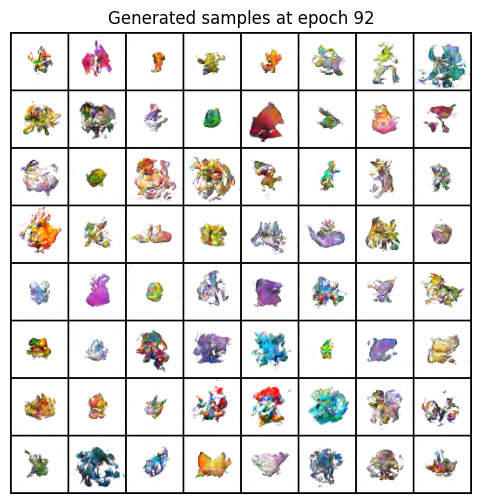

Epoch [93/100]  D_loss: 0.0934  G_loss: 3.6792


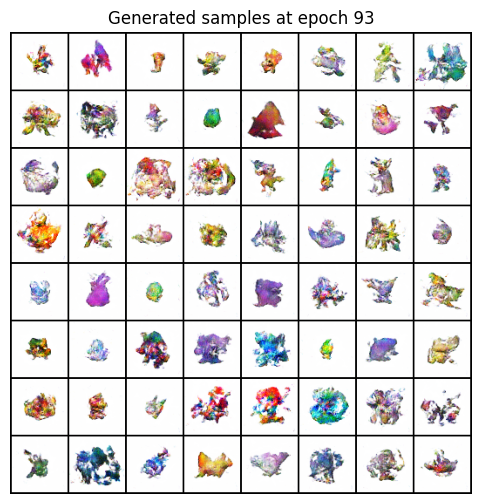

Epoch [94/100]  D_loss: 0.0468  G_loss: 4.6128


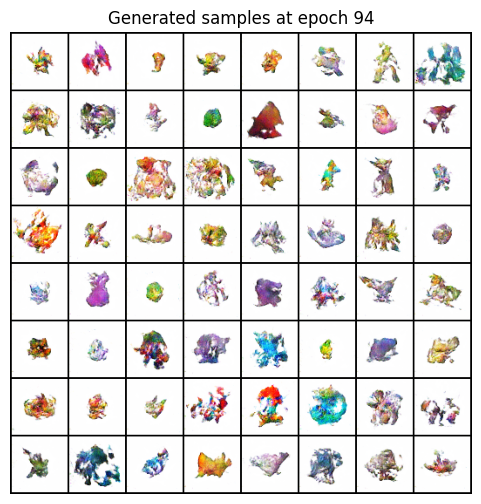

Epoch [95/100]  D_loss: 0.0730  G_loss: 4.6170


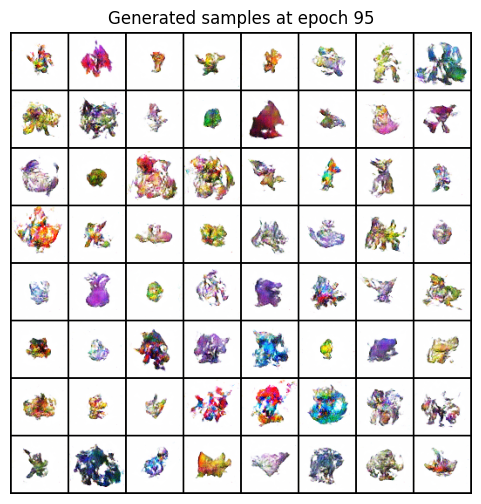

Epoch [96/100]  D_loss: 0.0302  G_loss: 4.8505


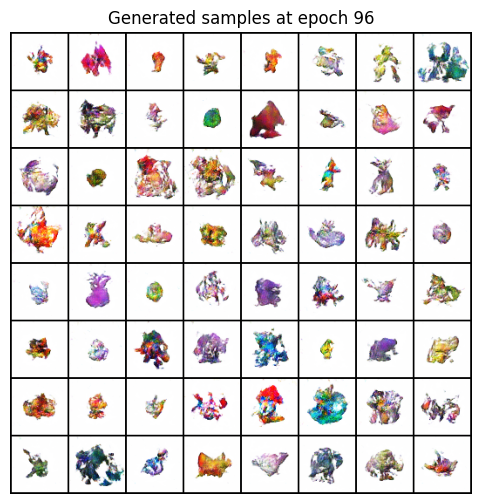

Epoch [97/100]  D_loss: 0.0488  G_loss: 4.1175


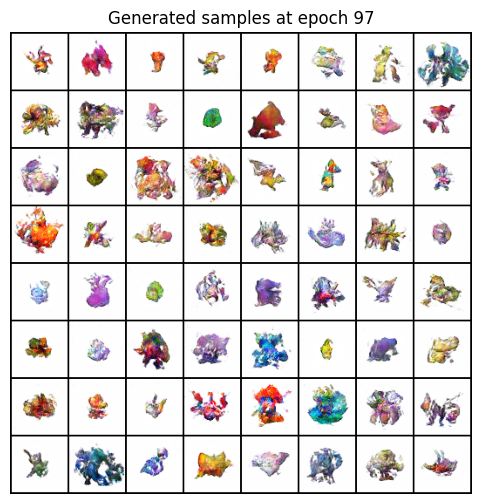

Epoch [98/100]  D_loss: 0.0568  G_loss: 4.8672


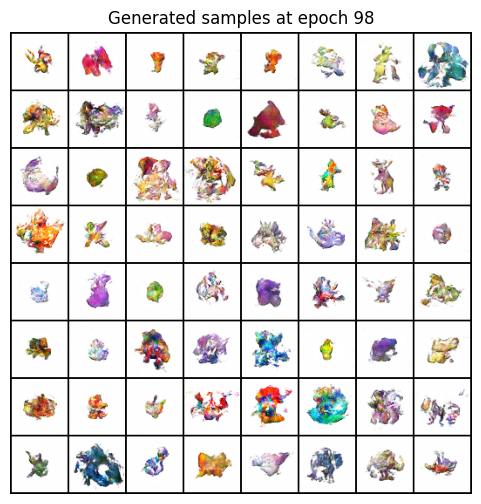

Epoch [99/100]  D_loss: 4.0230  G_loss: 14.8966


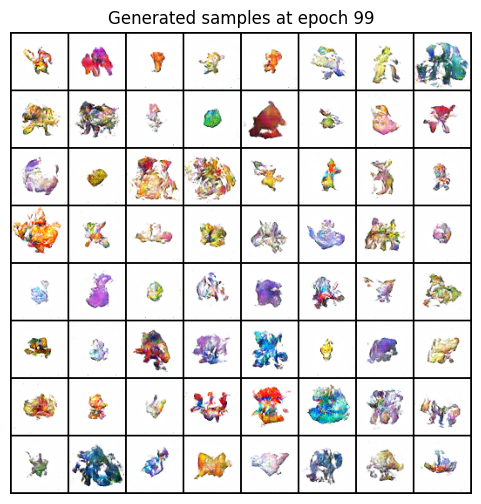

Epoch [100/100]  D_loss: 1.2532  G_loss: 1.2045


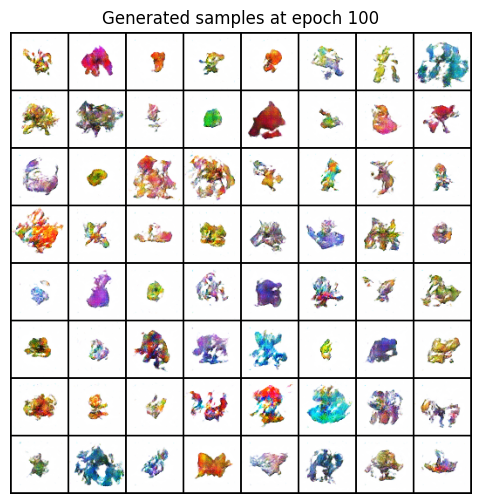

In [8]:
G.train()
D.train()

g_losses = []
d_losses = []

for epoch in range(1, num_epochs + 1):
    for real_imgs, _ in train_loader:
        real_imgs = real_imgs.to(device)

        # --------------------
        #  Train Discriminator
        # --------------------
        optimizer_D.zero_grad()

        # Prepare real and fake labels for future train
        real_labels = torch.ones(real_imgs.size(0), 1, device=device) # array of 1s for the selected images
        fake_labels = torch.zeros(real_imgs.size(0), 1, device=device) # array of 0s for the to-be-generated images

        outputs_real = D(real_imgs)
        d_loss_real = criterion(outputs_real, real_labels)

        # Fake images
        z = torch.randn(real_imgs.size(0), latent_dim, device=device)
        fake_imgs = G(z) # generate from noise
        outputs_fake = D(fake_imgs) # what does the discriminator think?
        d_loss_fake = criterion(outputs_fake, fake_labels)

        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optimizer_D.step()

        # ----------------
        #  Train Generator
        # ----------------
        optimizer_G.zero_grad()

        z = torch.randn(real_imgs.size(0), latent_dim, device=device)
        fake_imgs = G(z)
        outputs = D(fake_imgs)
        # Generator wants D to think fakes are real (label = 1)
        g_loss = criterion(outputs, real_labels)

        # backward and steps...
        g_loss.backward()
        optimizer_G.step()

        g_losses.append(g_loss.item())
        d_losses.append(d_loss.item())

    # clear_output(wait=True)
    print(f"Epoch [{epoch}/{num_epochs}]  D_loss: {d_loss.item():.4f}  G_loss: {g_loss.item():.4f}")
    show_fake_samples(epoch, fixed_noise)


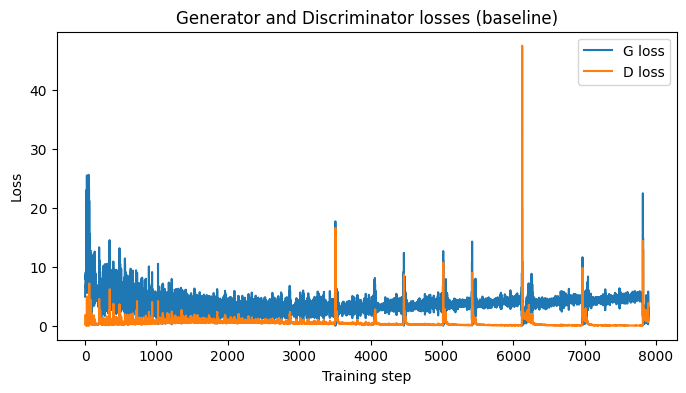

In [9]:
plt.figure(figsize=(8, 4))
plt.plot(g_losses, label='G loss')
plt.plot(d_losses, label='D loss')
plt.xlabel('Training step')
plt.ylabel('Loss')
plt.title('Generator and Discriminator losses (baseline)')
plt.legend()
plt.show()

In [10]:
import numpy as np
from scipy import linalg
from torchvision.models import inception_v3, Inception_V3_Weights

class InceptionV3Features(nn.Module):
    def __init__(self, device: torch.device):
        super().__init__()
        self.device = device
        inception = inception_v3(weights=Inception_V3_Weights.IMAGENET1K_V1)
        inception.eval()
        self.blocks = nn.Sequential(
            inception.Conv2d_1a_3x3,
            inception.Conv2d_2a_3x3,
            inception.Conv2d_2b_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2),
            inception.Conv2d_3b_1x1,
            inception.Conv2d_4a_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2),
            inception.Mixed_5b,
            inception.Mixed_5c,
            inception.Mixed_5d,
            inception.Mixed_6a,
            inception.Mixed_6b,
            inception.Mixed_6c,
            inception.Mixed_6d,
            inception.Mixed_6e,
            inception.Mixed_7a,
            inception.Mixed_7b,
            inception.Mixed_7c,
            nn.AdaptiveAvgPool2d(output_size=(1, 1))
        ).to(self.device)
        for param in self.blocks.parameters():
            param.requires_grad = False

    @torch.no_grad()
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # If input is grayscale, repeat to 3 channels
        if x.size(1) == 1:
            x = x.repeat(1, 3, 1, 1)

        x = (x + 1) / 2  # back to [0, 1]
        x = nn.functional.interpolate(x, size=(299, 299), mode='bilinear', align_corners=False)

        # Inception normalization
        mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(x.device)
        std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(x.device)
        x = (x - mean) / std

        features = self.blocks(x)
        return features.view(features.size(0), -1)

def calculate_frechet_distance(mu1, sigma1, mu2, sigma2, eps=1e-6):
    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)
    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    diff = mu1 - mu2
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    if np.iscomplexobj(covmean):
        covmean = covmean.real

    tr_covmean = np.trace(covmean)
    return diff.dot(diff) + np.trace(sigma1) + np.trace(sigma2) - 2 * tr_covmean

def get_features(images, model, device, max_samples=1000):
    model.eval()
    features_list = []
    n_samples = 0

    if isinstance(images, DataLoader):
        for batch in images:
            if isinstance(batch, (list, tuple)):
                batch = batch[0]
            batch = batch.to(device)
            with torch.no_grad():
                feat = model(batch)
            features_list.append(feat.cpu().numpy())
            n_samples += batch.size(0)
            if n_samples >= max_samples:
                break
    else:
        images = images.to(device)
        with torch.no_grad():
            feat = model(images)
        features_list.append(feat.cpu().numpy())

    return np.concatenate(features_list, axis=0)[:max_samples]

# Initialize Inception model
inception_model = InceptionV3Features(device)

# 1. Compute statistics for real images
print("Computing statistics for real images...")
real_features = get_features(train_loader, inception_model, device, max_samples=1000)
mu_real = np.mean(real_features, axis=0)
sigma_real = np.cov(real_features, rowvar=False)

# 2. Generate fake images
print("Generating fake images for FID calculation...")
G.eval()
with torch.no_grad():
    z = torch.randn(1000, latent_dim, device=device)
    fake_imgs = G(z)

# 3. Compute statistics for fake images
print("Computing statistics for fake images...")
fake_features = get_features(fake_imgs, inception_model, device, max_samples=1000)
mu_fake = np.mean(fake_features, axis=0)
sigma_fake = np.cov(fake_features, rowvar=False)

# 4. Calculate FID score
fid_score = calculate_frechet_distance(mu_real, sigma_real, mu_fake, sigma_fake)
print(f"FID Score: {fid_score:.4f}")

Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth


100%|██████████| 104M/104M [00:00<00:00, 207MB/s] 


Computing statistics for real images...
Generating fake images for FID calculation...
Computing statistics for fake images...


/tmp/ipython-input-3808186673.py:59: DeprecationWarning: The `disp` argument is deprecated and will be removed in SciPy 1.18.0.
  covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)


FID Score: 106.5718
